# Movies Analysis

#### The main purpose of this data analysis is to find out if there's a correlation between the rating of the movie and its box-office earnings. Movies high rated are always the ones that make more money?

### HYPOTHESIS

#### Other hypothesis we want to resolve:
####  1) Movie genre vs rating 
####  2) Movie genre vs awards - Why is hard for comedy movies to get to the Oscars? Note we could only get 380 registers from IMDb api because of the request limit


### DATA SOURCE
#### For this proyect we are going to work with two different data sources: Kaggle and IMDb API
#### KAGGLE: Originally this data was downloades from IMDb API but the we need more information from the API that is missing. From this data we are going to use mainly imdb_title_id, original_title, year, country, language, budget and worlwide_gross_income.
#### IMDb API: we are using imdb_title_id to make the request to the api and get the info about awards.





In [66]:
from IPython.display import Image
Image(url='https://media.giphy.com/media/kd9BlRovbPOykLBMqX/giphy.gif')

In [1]:
# Import Libraries

import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px
import plotly.graph_objects as go
import warnings

warnings.filterwarnings('ignore')

import plotly.express as px
import plotly.graph_objects as go

In [19]:
sns.set_context("poster")
sns.set(rc={"figure.figsize": (12.,6.)})
sns.set_style("whitegrid")

In [3]:
# Read and convert the csv source data into a pandas dataframe.
# KAGGLE

# pd.set_option('display.max_columns', None)
kaggle_movie_dataset_final = pd.read_csv("kaggle_movie_dataset_final.csv")

In [4]:
kaggle_movie_dataset_final.shape

(12268, 15)

In [5]:
# kaggle_movie_dataset_final.info()

In [6]:
# Change data types

kaggle_movie_dataset_final["genre"] = kaggle_movie_dataset_final["genre"].astype("category")
kaggle_movie_dataset_final["genre_main"] = kaggle_movie_dataset_final["genre_main"].astype("category")

In [7]:
# IMDb API

# pd.set_option('display.max_columns', None)
df_awards_final = pd.read_csv("df_awards_final.csv")

In [8]:
df_awards_final.head()

,imdb_title_id,otherNominationsCount,otherWinsCount,highlighted.awardName,highlighted.count
0,tt0242508,0,0,NaN,NaN
1,tt4080594,0,0,NaN,NaN
2,tt1294141,0,0,NaN,NaN
3,tt2088974,0,0,NaN,NaN
4,tt6584902,3,1,NaN,NaN


In [9]:
df_awards_final.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 885 entries, 0 to 884
Data columns (total 5 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   imdb_title_id          885 non-null    object 
 1   otherNominationsCount  885 non-null    int64  
 2   otherWinsCount         885 non-null    int64  
 3   highlighted.awardName  62 non-null     object 
 4   highlighted.count      62 non-null     float64
dtypes: float64(1), int64(2), object(2)
memory usage: 34.7+ KB


In [10]:
# Append budget, genre_main, worlwide_gross_income and weighted_average_vote to the kaggle_movie_dataset_final

columns_append = ['genre_main', 'worlwide_gross_income', 'weighted_average_vote']

kaggle_movie_dataset_final2 = kaggle_movie_dataset_final.merge(df_awards_final, on='imdb_title_id')

In [11]:
kaggle_movie_dataset_final2.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 383 entries, 0 to 382
Data columns (total 19 columns):
 #   Column                 Non-Null Count  Dtype   
---  ------                 --------------  -----   
 0   imdb_title_id          383 non-null    object  
 1   title                  383 non-null    object  
 2   original_title         383 non-null    object  
 3   year                   383 non-null    int64   
 4   genre                  383 non-null    category
 5   genre_main             383 non-null    category
 6   duration               383 non-null    int64   
 7   country                383 non-null    object  
 8   language               381 non-null    object  
 9   director               383 non-null    object  
 10  writer                 381 non-null    object  
 11  actors                 383 non-null    object  
 12  budget                 383 non-null    object  
 13  worlwide_gross_income  383 non-null    int64   
 14  weighted_average_vote  383 non-null    flo

#### Unfortunately we made the requests from a sample of kaggle dataset before we filtered out dollar currency only so we ended up only with 383 matching the criteria we wanted

## MAIN HYPOTHESIS: Movies high rated are always the ones that make more money?

Before getting hands on with this hypothesis, let's get a brief idea about how data is distributed by genre

In [12]:
fig = px.box(kaggle_movie_dataset_final, x="genre_main", y="worlwide_gross_income", color="genre_main")
fig.show()

We see actions movies has quite a lot outliers smashing box-office earnings, followed by animation movies

### ALL GENRES

#### In order to make a fair comparison between movies for the gross income, we are going to select movies just from 2000's so inflation doesn't affect much

In [17]:
kaggle_movie_dataset_final_2000 = kaggle_movie_dataset_final[(kaggle_movie_dataset_final["year"]>= 2000)]

<AxesSubplot:xlabel='worlwide_gross_income', ylabel='weighted_average_vote'>

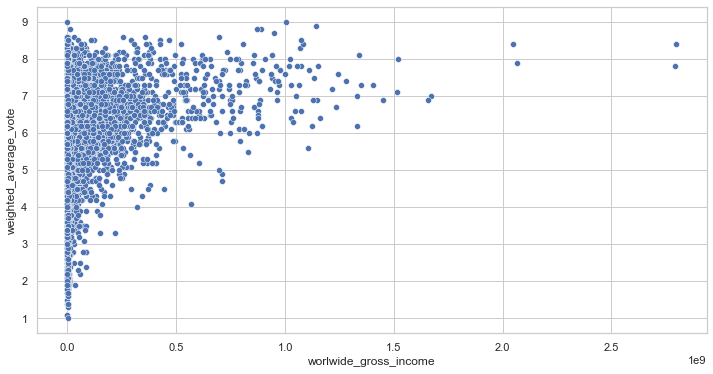

In [20]:
sns.scatterplot(x="worlwide_gross_income", y="weighted_average_vote", data=kaggle_movie_dataset_final_2000)

The mayority of the movie would be alocated with a rating between 5 and 7 and reaching box-office earnings between 0 and 200 million dollars. This is telling us that for mayority of the cases not because the movie is hight rated means it is going to smash the box-office earnings. 
We also see few cases of low rating movies making quite a lot of money

### By year from 1970

In [27]:
fig = px.scatter(kaggle_movie_dataset_final.sort_values(by='year', ascending = True),
                        x="worlwide_gross_income",
                        y="weighted_average_vote",
                        
                        opacity = 0.5, 
                        animation_frame=kaggle_movie_dataset_final.sort_values(by='year', ascending = True)["year"]
                        )
fig.update_layout(height=600, margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

### We are going to analysis now rating vs box-office by genre

### ACTION MOVIES (2000s)

In [35]:
action_movies_2000 = kaggle_movie_dataset_final_2000[kaggle_movie_dataset_final_2000['genre_main'] == "Action"]
action_movies.shape

(2565, 15)

In [36]:
fig = px.scatter(action_movies_2000, x="worlwide_gross_income", y="weighted_average_vote", color="original_title")
fig.update_layout(showlegend=False)
fig.show()

### By year

In [37]:
fig = px.scatter(action_movies_2000.sort_values(by='year', ascending = True),
                        x="worlwide_gross_income",
                        y="weighted_average_vote",
                        color="original_title",
#                         opacity = 0.5, 
                        animation_frame=action_movies_2000.sort_values(by='year', ascending = True)["year"]
                        )
fig.update_layout(height=600, margin={"r":0,"t":0,"l":0,"b":0})
fig.update_layout(showlegend=False)
fig.show()

### DRAMA MOVIES (2000s)

In [38]:
drama_movies_2000 = kaggle_movie_dataset_final_2000[kaggle_movie_dataset_final['genre_main'] == "Drama"]

In [39]:
fig = px.scatter(drama_movies_2000, x="worlwide_gross_income", y="weighted_average_vote", color="original_title")
fig.update_layout(showlegend=False)
fig.show()

### By year

In [40]:
fig = px.scatter(drama_movies_2000.sort_values(by='year', ascending = True),
                        x="worlwide_gross_income",
                        y="weighted_average_vote",
                        color="original_title",
#                         opacity = 0.5, 
                        animation_frame=drama_movies_2000.sort_values(by='year', ascending = True)["year"]
                        )
fig.update_layout(height=600, margin={"r":0,"t":0,"l":0,"b":0})
fig.update_layout(showlegend=False)
fig.show()

### COMEDY MOVIES (2000s)

In [41]:
comedy_movies_2000 = kaggle_movie_dataset_final_2000[kaggle_movie_dataset_final['genre_main'] == "Comedy"]

In [43]:
fig = px.scatter(comedy_movies_2000, x="worlwide_gross_income", y="weighted_average_vote", color="original_title")
fig.update_layout(showlegend=False)
fig.show()

### By year

In [44]:
fig = px.scatter(comedy_movies_2000.sort_values(by='year', ascending = True),
                        x="worlwide_gross_income",
                        y="weighted_average_vote",
                        color="original_title",
#                         opacity = 0.5, 
                        animation_frame=comedy_movies_2000.sort_values(by='year', ascending = True)["year"]
                        )
fig.update_layout(height=600, margin={"r":0,"t":0,"l":0,"b":0})
fig.update_layout(showlegend=False)
fig.show()

### CRIME MOVIES (2000's)

In [45]:
crime_movies_2000 = kaggle_movie_dataset_final_2000[kaggle_movie_dataset_final['genre_main'] == "Crime"]

In [46]:
fig = px.scatter(crime_movies_2000, x="worlwide_gross_income", y="weighted_average_vote", color="original_title")
fig.update_layout(showlegend=False)
fig.show()

### By year

In [47]:
fig = px.scatter(crime_movies_2000.sort_values(by='year', ascending = True),
                        x="worlwide_gross_income",
                        y="weighted_average_vote",
                        color="original_title",
#                         opacity = 0.5, 
                        animation_frame=crime_movies_2000.sort_values(by='year', ascending = True)["year"]
                        )
fig.update_layout(height=600, margin={"r":0,"t":0,"l":0,"b":0})
fig.update_layout(showlegend=False)
fig.show()

### ADVENTURE MOVIES (2000's)

In [48]:
adventure_movies_2000 = kaggle_movie_dataset_final_2000[kaggle_movie_dataset_final['genre_main'] == "Adventure"]

In [49]:
fig = px.scatter(adventure_movies_2000, x="worlwide_gross_income", y="weighted_average_vote", color="original_title")
fig.update_layout(showlegend=False)
fig.show()

### By year

In [50]:
fig = px.scatter(adventure_movies_2000.sort_values(by='year', ascending = True),
                        x="worlwide_gross_income",
                        y="weighted_average_vote",
                        color="original_title",
#                         opacity = 0.5, 
                        animation_frame=adventure_movies_2000.sort_values(by='year', ascending = True)["year"]
                        )
fig.update_layout(height=600, margin={"r":0,"t":0,"l":0,"b":0})
fig.update_layout(showlegend=False)
fig.show()

### HORROR MOVIES (2000's)

In [51]:
horror_movies_2000 = kaggle_movie_dataset_final_2000[kaggle_movie_dataset_final['genre_main'] == "Horror"]

In [54]:
fig = px.scatter(horror_movies_2000, x="worlwide_gross_income", y="weighted_average_vote", color="original_title")
fig.update_layout(showlegend=False)
fig.show()

### By year

In [55]:
fig = px.scatter(horror_movies_2000.sort_values(by='year', ascending = True),
                        x="worlwide_gross_income",
                        y="weighted_average_vote",
                        color="original_title",
#                         opacity = 0.5, 
                        animation_frame=horror_movies_2000.sort_values(by='year', ascending = True)["year"]
                        )
fig.update_layout(height=600, margin={"r":0,"t":0,"l":0,"b":0})
fig.update_layout(showlegend=False)
fig.show()

### ANIMATION MOVIES (2000's)

In [56]:
animation_movies_2000 = kaggle_movie_dataset_final_2000[kaggle_movie_dataset_final['genre_main'] == "Animation"]

In [57]:
fig = px.scatter(animation_movies_2000, x="worlwide_gross_income", y="weighted_average_vote", color="original_title")
fig.update_layout(showlegend=False)
fig.show()

### By year

In [58]:
fig = px.scatter(animation_movies_2000.sort_values(by='year', ascending = True),
                        x="worlwide_gross_income",
                        y="weighted_average_vote",
                        color="original_title",
#                         opacity = 0.5, 
                        animation_frame=animation_movies_2000.sort_values(by='year', ascending = True)["year"]
                        )
fig.update_layout(height=600, margin={"r":0,"t":0,"l":0,"b":0})
fig.update_layout(showlegend=False)
fig.show()

### THRILLER MOVIES (2000's)

In [59]:
thriller_movies_2000 = kaggle_movie_dataset_final_2000[kaggle_movie_dataset_final['genre_main'] == "Thriller"]

In [60]:
fig = px.scatter(thriller_movies_2000, x="worlwide_gross_income", y="weighted_average_vote", color="original_title")
fig.update_layout(showlegend=False)
fig.show()

### By year

In [61]:
fig = px.scatter(thriller_movies_2000.sort_values(by='year', ascending = True),
                        x="worlwide_gross_income",
                        y="weighted_average_vote",
                        color="original_title",
#                         opacity = 0.5, 
                        animation_frame=thriller_movies_2000.sort_values(by='year', ascending = True)["year"]
                        )
fig.update_layout(height=600, margin={"r":0,"t":0,"l":0,"b":0})
fig.update_layout(showlegend=False)
fig.show()

## HYPOTHESIS: Movie genre vs rating

In [62]:
fig = px.box(kaggle_movie_dataset_final, x="genre_main", y="weighted_average_vote", color="genre_main")
fig.show()

This boxplot show us that biography and animation movies have a higher rating median. On the contrary horror and thrillers movies are not considered as good as the rest of the genres

## HYPOTHESIS Movie genre vs awards - Why is so hard for comedy movies to get to the Oscars?

We are trying to prove here that not many comedy movies get awarded with highlighted awards (Oscars and BAFTA film awards)

In [63]:
fig = px.bar(kaggle_movie_dataset_final2, x = "genre_main", y = "highlighted.count")
fig.show()
# fig.update_layout(showlegend=False)


In [64]:
dict(kaggle_movie_dataset_final2["highlighted.awardName"].value_counts())

{'Oscar': 22, 'BAFTA Film Award': 4}

This confirms that comedy movies don't get as many highlighted awards as action or drama movies. Still it is in the top 3